<a href="https://colab.research.google.com/github/Manpreethub/yolo-model_MK/blob/main/soil_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# ===========================================
# 1️⃣ INSTALL DEPENDENCIES
# ===========================================
!pip install ultralytics --quiet
!pip install opencv-python-headless matplotlib --quiet

In [ ]:
# ===========================================
# 2️⃣ MOUNT GOOGLE DRIVE
# ===========================================
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
import os
print(os.listdir("/content/drive/MyDrive/yolov11"))


['results', 'Soil detection']


In [ ]:
base_path = "/content/drive/MyDrive/yolov11/Soil detection"
print("📂 Dataset folders:", os.listdir(base_path))


📂 Dataset folders: ['README.roboflow.txt', 'README.dataset.txt', 'test', 'train', 'valid', 'data.yaml']


In [ ]:
import glob

train_labels = glob.glob(os.path.join(base_path, "train/labels/*.txt"))
classes = set()

for label_file in train_labels:
    with open(label_file, "r") as f:
        for line in f.readlines():
            classes.add(int(line.split()[0]))

print("✅ Detected class IDs:", classes)



✅ Detected class IDs: {0, 1, 2, 3}


In [ ]:
import yaml

with open("/content/drive/MyDrive/yolov11/Soil detection/data.yaml", "r") as f:
    data = yaml.safe_load(f)

print(data)


{'names': ['soil_class_1', 'soil_class_2'], 'nc': 2, 'path': '/content/drive/MyDrive/yolov11/Soil detection', 'test': 'test/images', 'train': 'train/images', 'val': 'valid/images'}


In [ ]:
import os, yaml

base_path = "/content/drive/MyDrive/yolov11/Soil detection"

class_map = {
    0: "soil_class_1",
    1: "soil_class_2"
}

data_yaml = {
    'path': base_path,
    'train': 'train/images',
    'val': 'valid/images',  # corrected from test/images
    'test': 'test/images',
    'nc': len(class_map),
    'names': [class_map[i] for i in range(len(class_map))]
}

yaml_path = os.path.join(base_path, "data.yaml")
with open(yaml_path, "w") as f:
    yaml.dump(data_yaml, f)

print("✅ data.yaml updated successfully at:", yaml_path)
print(yaml.safe_load(open(yaml_path)))


✅ data.yaml updated successfully at: /content/drive/MyDrive/yolov11/Soil detection/data.yaml
{'names': ['soil_class_1', 'soil_class_2'], 'nc': 2, 'path': '/content/drive/MyDrive/yolov11/Soil detection', 'test': 'test/images', 'train': 'train/images', 'val': 'valid/images'}


In [ ]:
import os

results_dir = "/content/drive/MyDrive/yolov11/results"
print("Contents of results folder:", os.listdir(results_dir))


Contents of results folder: ['soil_yolov11']


In [ ]:
import os

weights_dir = "/content/drive/MyDrive/yolov11/results/soil_yolov11/weights"
print("Available weights:", os.listdir(weights_dir))


Available weights: ['best.pt', 'last.pt']


In [ ]:
from ultralytics import YOLO

weights_path = "/content/drive/MyDrive/yolov11/results/soil_yolov11/weights/best.pt"
model = YOLO(weights_path)


In [ ]:
data_yaml = "/content/drive/MyDrive/yolov11/Soil detection/data.yaml"

model.train(
    data=data_yaml,
    epochs=60,
    batch=16,
    imgsz=640,
    device=0,
    project="/content/drive/MyDrive/yolov11/results",
    name="soil_yolov11",
    exist_ok=True
)


Ultralytics 8.3.214 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/yolov11/Soil detection/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=60, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/drive/MyDrive/yolov11/results/soil_yolov11/weights/best.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=soil_yolov11, nbs=64, nms=False, opset=None, optimize=Fals

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7db6a80747a0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04804

In [ ]:
metrics = model.val(
    data=data_yaml,
    split="test",
    imgsz=640,
    batch=16,
    device=0
)
print("📊 Validation Metrics:", metrics)


Ultralytics 8.3.214 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
val: Fast image access ✅ (ping: 0.5±0.2 ms, read: 50.0±7.7 MB/s, size: 91.3 KB)
val: Scanning /content/drive/MyDrive/yolov11/Soil detection/test/labels.cache... 28 images, 0 backgrounds, 11 corrupt: 100% ━━━━━━━━━━━━ 28/28 56.2Kit/s 0.0s
val: /content/drive/MyDrive/yolov11/Soil detection/test/images/Clay_47_jpg.rf.75ea8b632fb8f5e1a540b31945d9ff4d.jpg: ignoring corrupt image/label: Label class 2 exceeds dataset class count 2. Possible class labels are 0-1
val: /content/drive/MyDrive/yolov11/Soil detection/test/images/Copy-of-clay-soil-cropped_jpg.rf.9dfcef24065c2fa79a282f89bff22b80.jpg: ignoring corrupt image/label: Label class 2 exceeds dataset class count 2. Possible class labels are 0-1
val: /content/drive/MyDrive/yolov11/Soil detection/test/images/Copy-of-image14_jpeg.rf.4e376475395c1adc2faba2ce470bf93e.jpg: ignoring corrupt image/label: Label class 3 exceeds dataset class count 2. Possible class labe


image 1/1 /content/drive/MyDrive/yolov11/Soil detection/test/images/Copy-of-image15_jpeg.rf.4dcea00f6cf966d634e331ab311cbdca.jpg: 640x640 1 soil_class_1, 1 soil_class_2, 10.3ms
Speed: 2.3ms preprocess, 10.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/detect/predict5


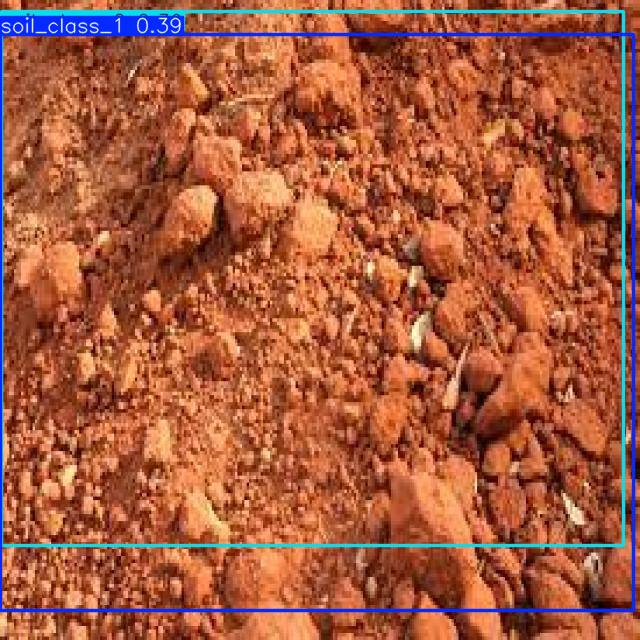

In [ ]:
import glob

sample_image = glob.glob("/content/drive/MyDrive/yolov11/Soil detection/test/images/*.jpg")[0]

result = model.predict(
    source=sample_image,
    save=True,
    imgsz=640,
    conf=0.25,
    device=0
)

result[0].show()



0: 640x640 1 soil_class_1, 1 soil_class_2, 4.5ms
1: 640x640 1 soil_class_1, 4.5ms
2: 640x640 1 soil_class_1, 4.5ms
3: 640x640 2 soil_class_1s, 1 soil_class_2, 4.5ms
4: 640x640 1 soil_class_2, 4.5ms
5: 640x640 1 soil_class_1, 4.5ms
6: 640x640 2 soil_class_2s, 4.5ms
7: 640x640 1 soil_class_1, 4.5ms
8: 640x640 1 soil_class_1, 4.5ms
9: 640x640 1 soil_class_1, 4.5ms
10: 640x640 1 soil_class_2, 4.5ms
11: 640x640 1 soil_class_2, 4.5ms
12: 640x640 1 soil_class_1, 4.5ms
13: 640x640 1 soil_class_1, 4.5ms
14: 640x640 1 soil_class_1, 4.5ms
15: 640x640 1 soil_class_1, 4.5ms
16: 640x640 1 soil_class_1, 4.5ms
17: 640x640 1 soil_class_1, 4.5ms
18: 640x640 1 soil_class_2, 4.5ms
19: 640x640 1 soil_class_1, 4.5ms
20: 640x640 1 soil_class_2, 4.5ms
21: 640x640 1 soil_class_2, 4.5ms
22: 640x640 1 soil_class_1, 4.5ms
23: 640x640 1 soil_class_1, 4.5ms
24: 640x640 1 soil_class_1, 4.5ms
25: 640x640 1 soil_class_1, 4.5ms
26: 640x640 1 soil_class_2, 4.5ms
27: 640x640 (no detections), 4.5ms
Speed: 1.8ms preproces

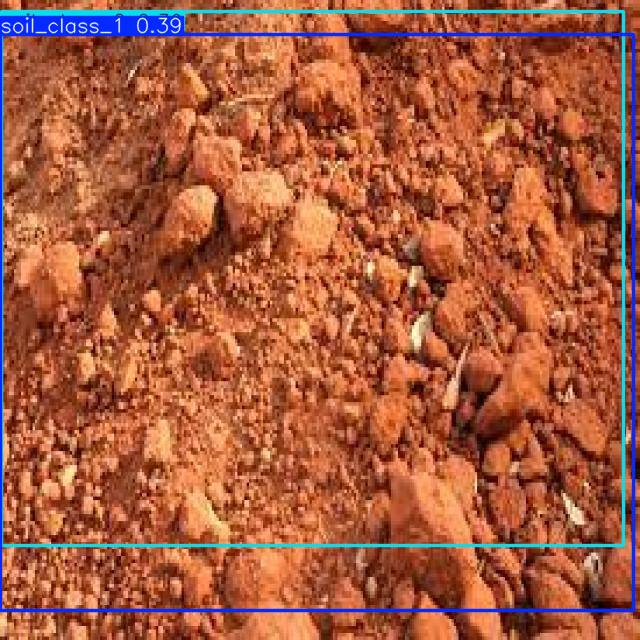

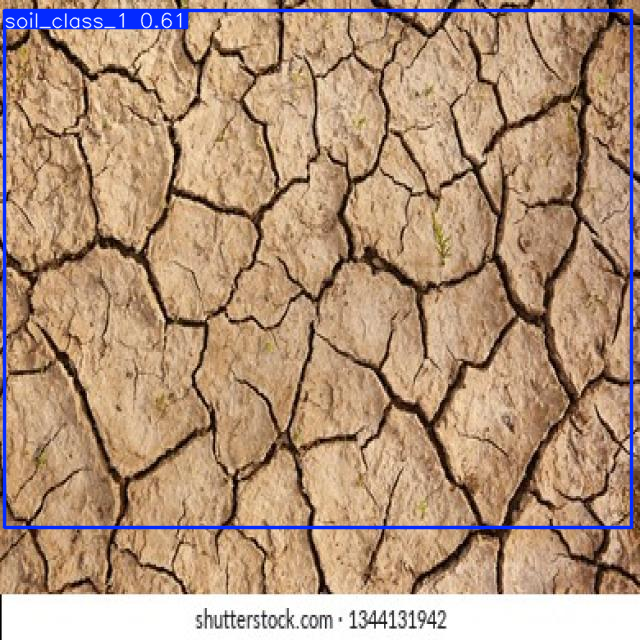

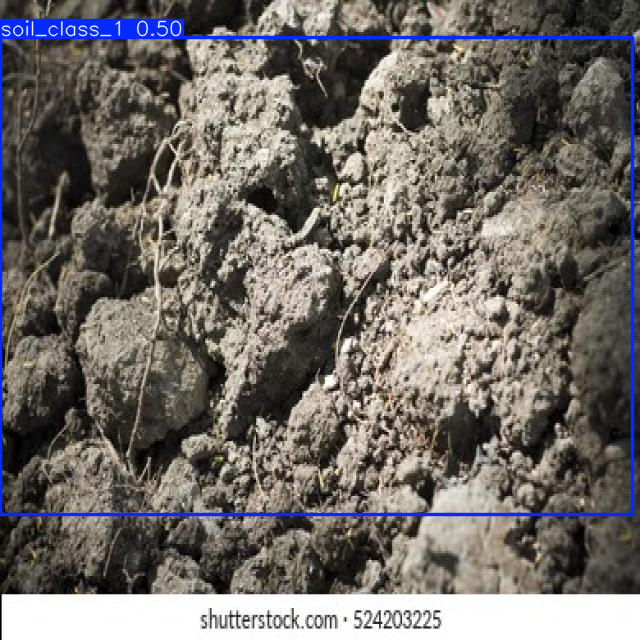

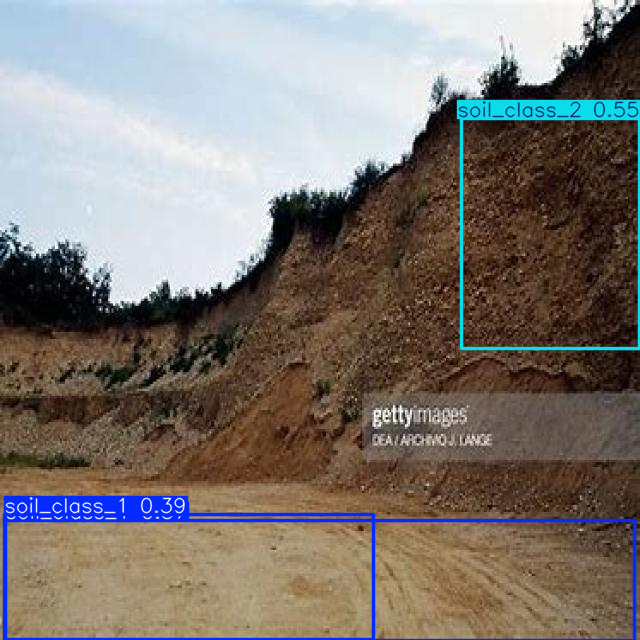

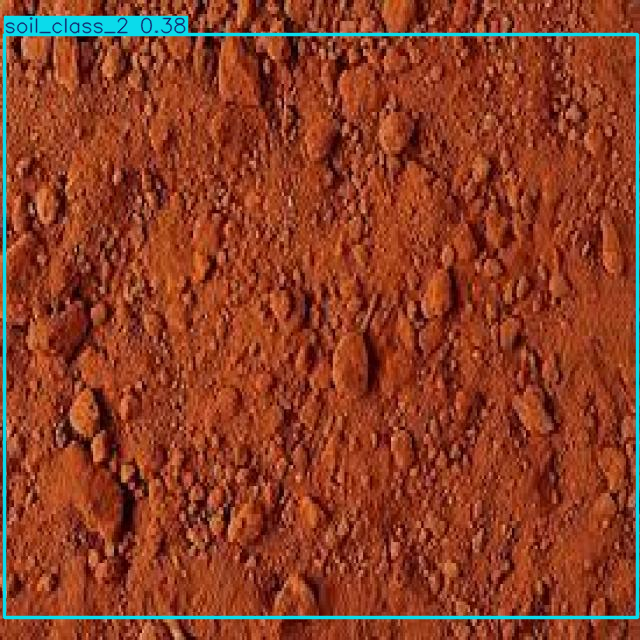

...

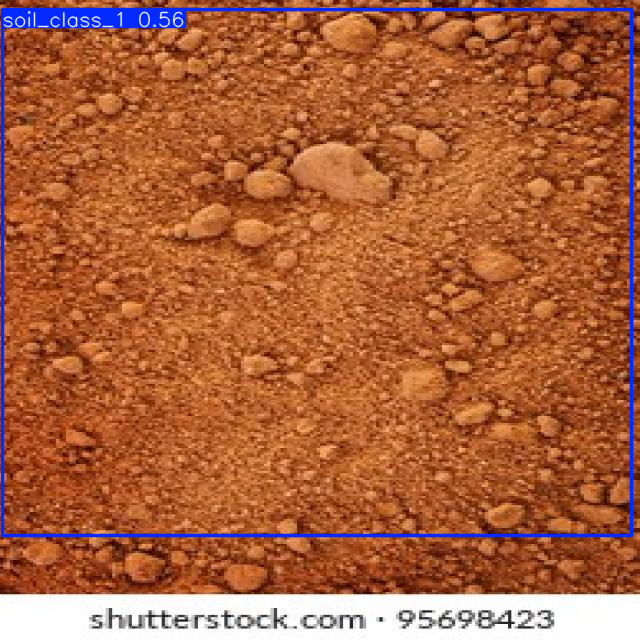

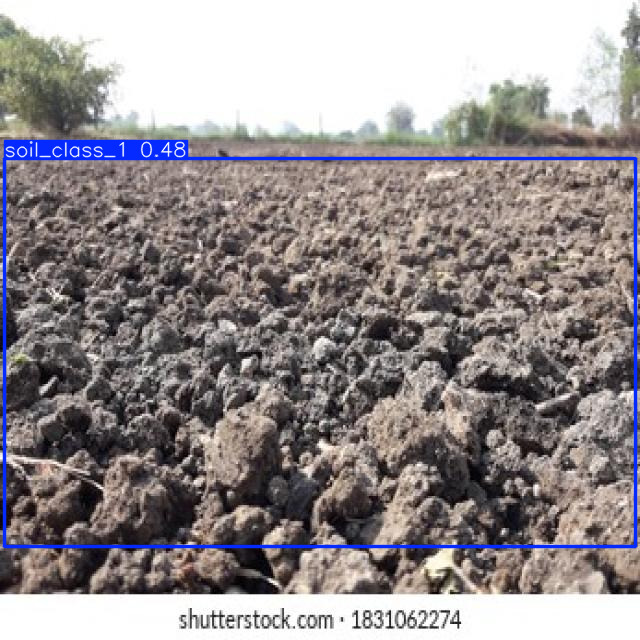

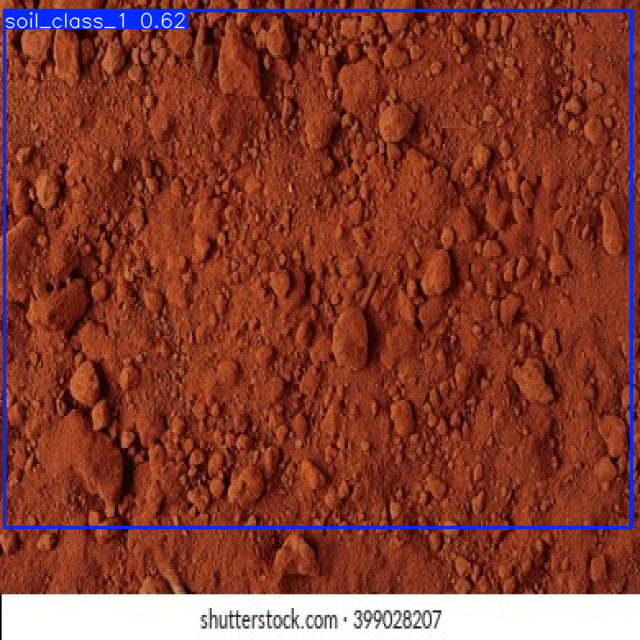

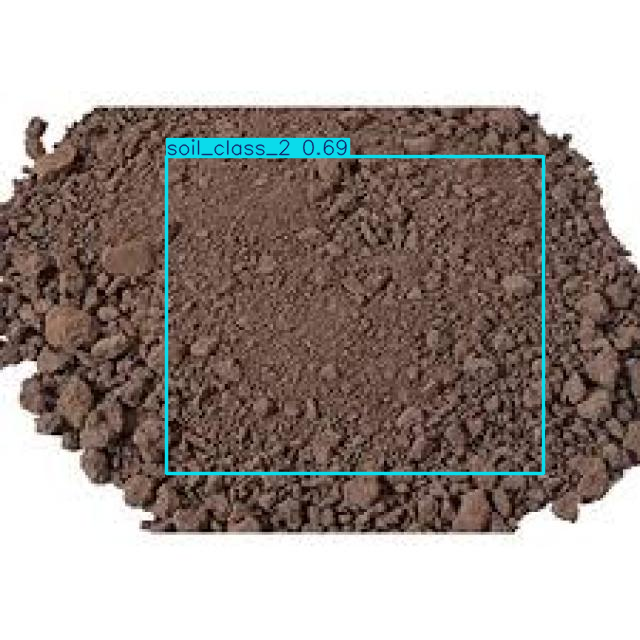

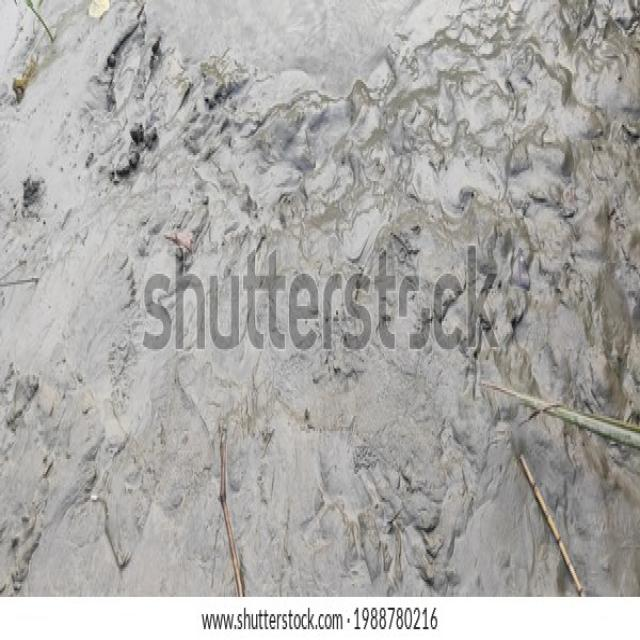

In [ ]:
from ultralytics import YOLO
import glob
from IPython.display import display, Image

# Load your trained model
weights_path = "/content/drive/MyDrive/yolov11/results/soil_yolov11/weights/best.pt"
model = YOLO(weights_path)

# Folder containing test images
test_images = glob.glob("/content/drive/MyDrive/yolov11/Soil detection/test/images/*.jpg")

# Run prediction on all images
results = model.predict(
    source=test_images,  # list of images
    save=True,           # save images with bounding boxes
    imgsz=640,
    conf=0.25,
    device=0
)

# Display all images inline
for r in results:
    r.show()  # shows image with bounding boxes and class names


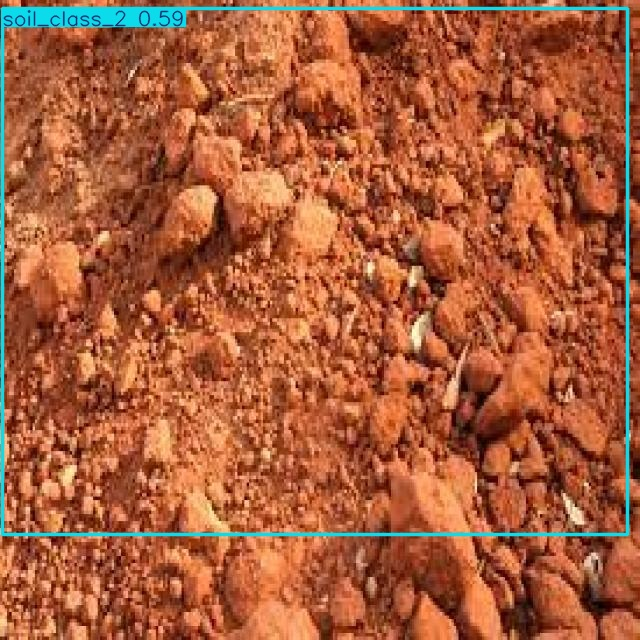

In [ ]:
import os
from IPython.display import display, Image

predict_folder = "/content/runs/detect/predict"
for img_file in os.listdir(predict_folder):
    if img_file.endswith(".jpg"):
        display(Image(filename=os.path.join(predict_folder, img_file)))


In [ ]:
# 3️⃣ LOAD TRAINED MODEL (✅ CORRECT PATH)
# ===========================================
weights_path = "/content/drive/MyDrive/yolov11/results/soil_yolov11/weights/best.pt"
model = YOLO(weights_path)
print("✅ Model loaded successfully!")

✅ Model loaded successfully!


In [ ]:
# 4️⃣ DEFINE CLASS NAMES (4 TYPES)
# ===========================================
class_map = {
    0: "Alluvial Soil",
    1: "Black Soil",
    2: "Brown Soil",
    3: "Red Soil"
}

In [ ]:
import os

# Check your test image folder
test_dir = "/content/drive/MyDrive/yolov11"
for root, dirs, files in os.walk(test_dir):
    for f in files:
        if f.endswith(('.jpg', '.png', '.jpeg')):
            print(os.path.join(root, f))


/content/drive/MyDrive/yolov11/results/soil_yolov11/labels.jpg
/content/drive/MyDrive/yolov11/results/soil_yolov11/train_batch0.jpg
/content/drive/MyDrive/yolov11/results/soil_yolov11/train_batch1.jpg
/content/drive/MyDrive/yolov11/results/soil_yolov11/train_batch2.jpg
/content/drive/MyDrive/yolov11/results/soil_yolov11/train_batch401.jpg
/content/drive/MyDrive/yolov11/results/soil_yolov11/train_batch400.jpg
/content/drive/MyDrive/yolov11/results/soil_yolov11/train_batch402.jpg
/content/drive/MyDrive/yolov11/results/soil_yolov11/val_batch1_pred.jpg
/content/drive/MyDrive/yolov11/results/soil_yolov11/val_batch1_labels.jpg
/content/drive/MyDrive/yolov11/results/soil_yolov11/BoxR_curve.png
/content/drive/MyDrive/yolov11/results/soil_yolov11/BoxP_curve.png
/content/drive/MyDrive/yolov11/results/soil_yolov11/val_batch0_labels.jpg
/content/drive/MyDrive/yolov11/results/soil_yolov11/BoxF1_curve.png
/content/drive/MyDrive/yolov11/results/soil_yolov11/val_batch0_pred.jpg
/content/drive/MyDrive/

In [ ]:
from ultralytics import YOLO
model = YOLO("/content/drive/MyDrive/yolov11/results/soil_yolov11/weights/best.pt")
results = model.predict(source="/content/drive/MyDrive/yolov11/Soil detection/test/images", save=True)


image 1/28 /content/drive/MyDrive/yolov11/Soil detection/test/images/Black_38_jpg.rf.cce2afe5e739cb1d77fbdfd7d51d5012.jpg: 640x640 1 soil_class_2, 8.1ms
image 2/28 /content/drive/MyDrive/yolov11/Soil detection/test/images/Black_44_jpg.rf.bfb078e5b0304edb36b2cc1d57ea3cbc.jpg: 640x640 1 soil_class_2, 8.0ms
image 3/28 /content/drive/MyDrive/yolov11/Soil detection/test/images/Black_47_jpg.rf.30fa0ac078480d4fbb2bdb6bd4c189c3.jpg: 640x640 1 soil_class_2, 8.0ms
image 4/28 /content/drive/MyDrive/yolov11/Soil detection/test/images/Clay_47_jpg.rf.75ea8b632fb8f5e1a540b31945d9ff4d.jpg: 640x640 1 soil_class_1, 8.0ms
image 5/28 /content/drive/MyDrive/yolov11/Soil detection/test/images/Copy-of-clay-soil-cropped_jpg.rf.9dfcef24065c2fa79a282f89bff22b80.jpg: 640x640 1 soil_class_1, 8.1ms
image 6/28 /content/drive/MyDrive/yolov11/Soil detection/test/images/Copy-of-image14_jpeg.rf.4e376475395c1adc2faba2ce470bf93e.jpg: 640x640 1 soil_class_2, 7.9ms
image 7/28 /content/drive/MyDrive/yolov11/Soil detection/

Displaying: Red_43_jpg.rf.65ef688a7c7195195ddaaf0595d44036.jpg


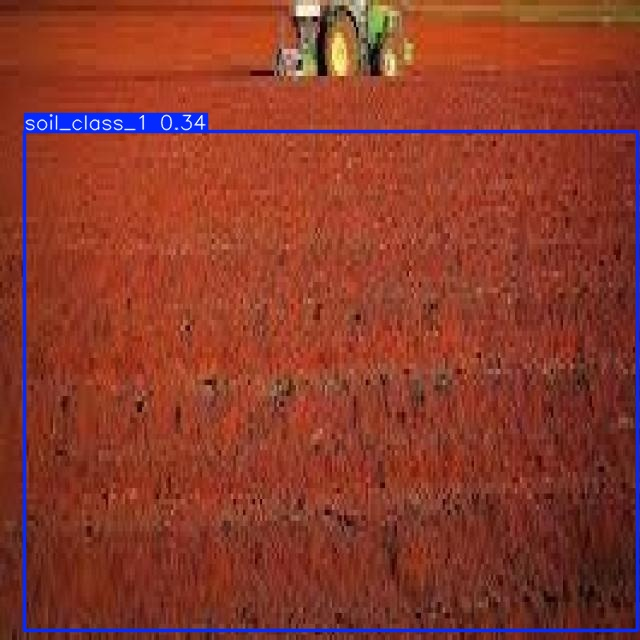

Displaying: OIP-KVkf9QJRKPigCm0hKBI3qAEsDh_jpg.rf.1d286073555a8bb4141a928f57e3c1a7.jpg


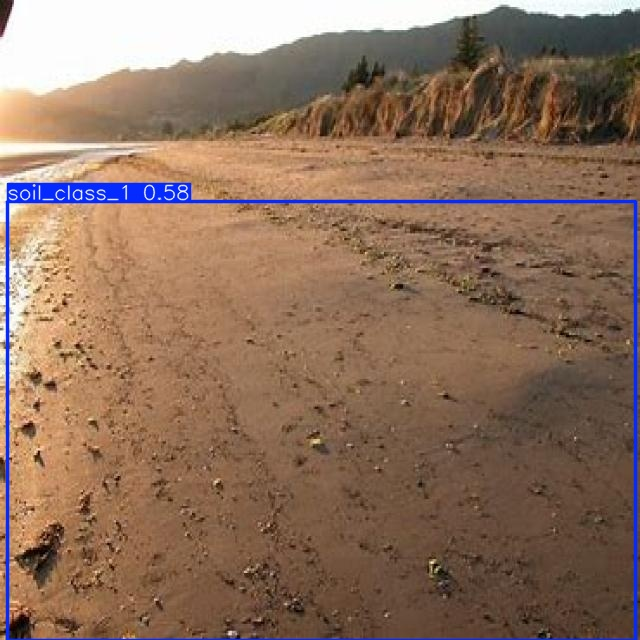

Displaying: ground-texture-top-view-red-260nw-399028207_jpg.rf.1bf7a46c8069046671723ee525d238a7.jpg


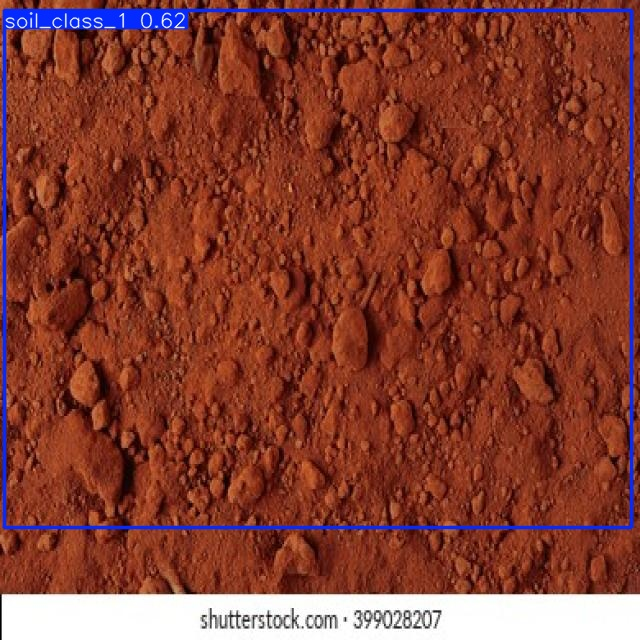

Displaying: Copy-of-image14_jpeg.rf.4e376475395c1adc2faba2ce470bf93e.jpg


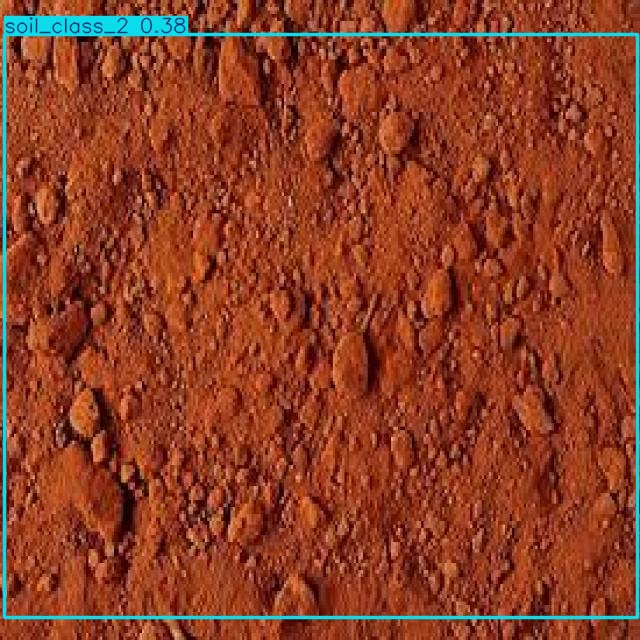

Displaying: vertical-texture-red-dry-clay-260nw-95698423_jpg.rf.84b5a11a0df3b6a6218f7db86afb31d6.jpg


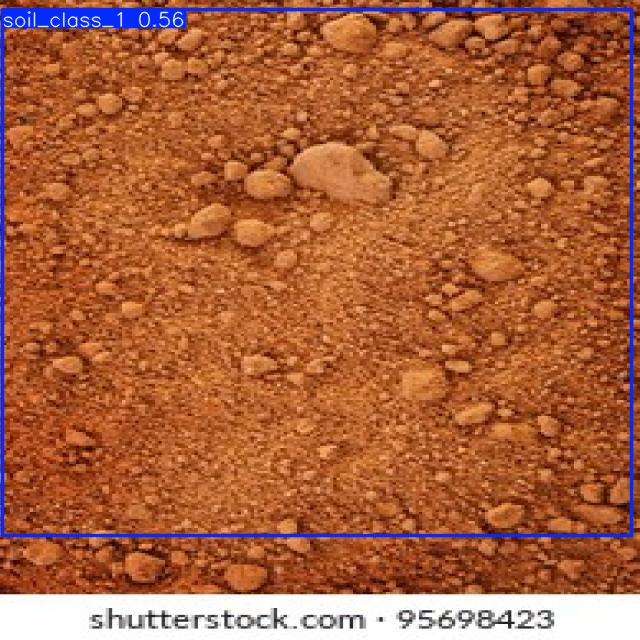

Displaying: red-sand-260nw-35713183_jpg.rf.a6e686ebde584e73b3059993255c0bb6.jpg


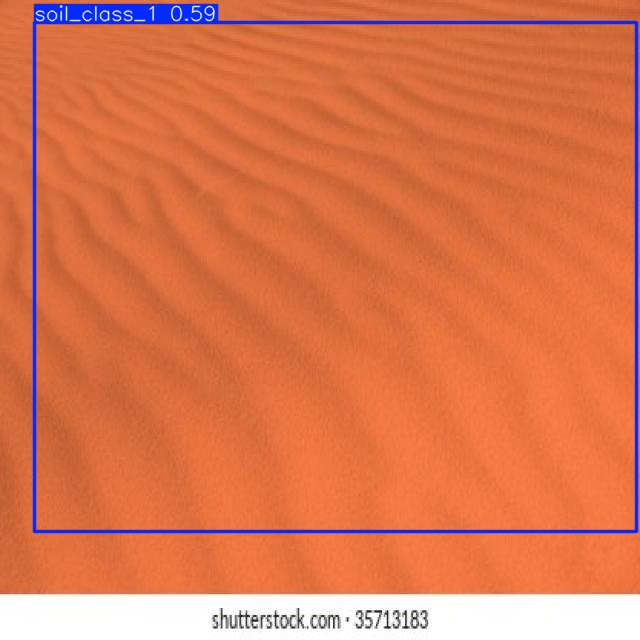

Displaying: OIP-uApXs3Gbx3mU71-BGTLf3gHaE-_jpg.rf.338bfd49f3b7683778e94bc54ffb1804.jpg


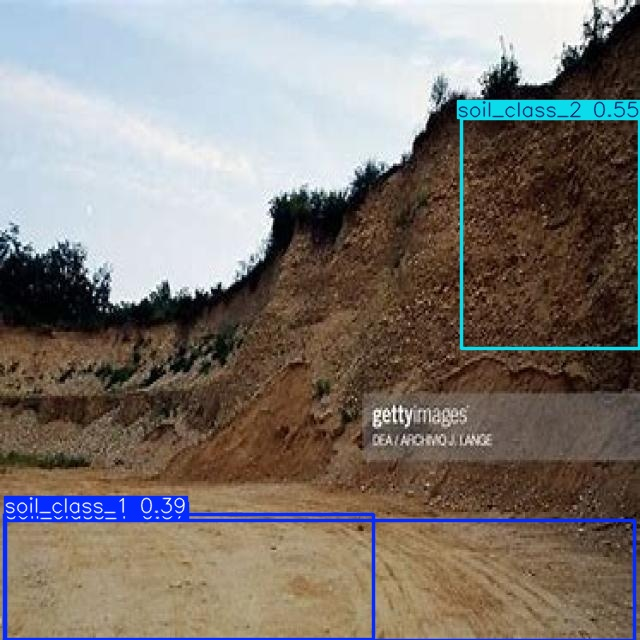

Displaying: texture-dried-earth-clay-sand-260nw-1344131942_jpg.rf.fa25c57e4bc188d33b298abed17ac9f6.jpg


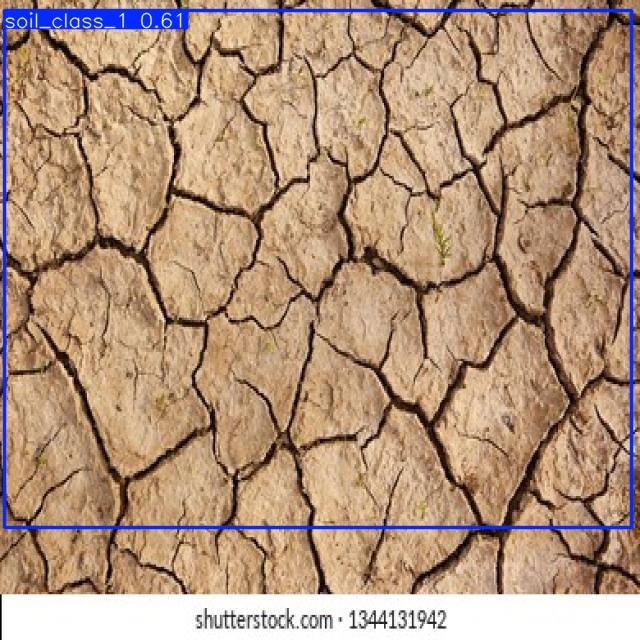

Displaying: Black_47_jpg.rf.30fa0ac078480d4fbb2bdb6bd4c189c3.jpg


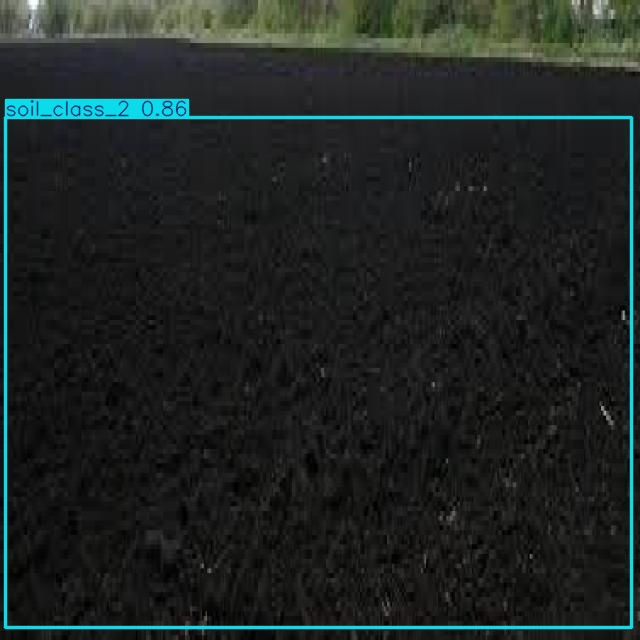

Displaying: footprint-on-ground-soil-green-260nw-1989753302_jpg.rf.471b75f9a457fe6b2b930f03a526681c.jpg


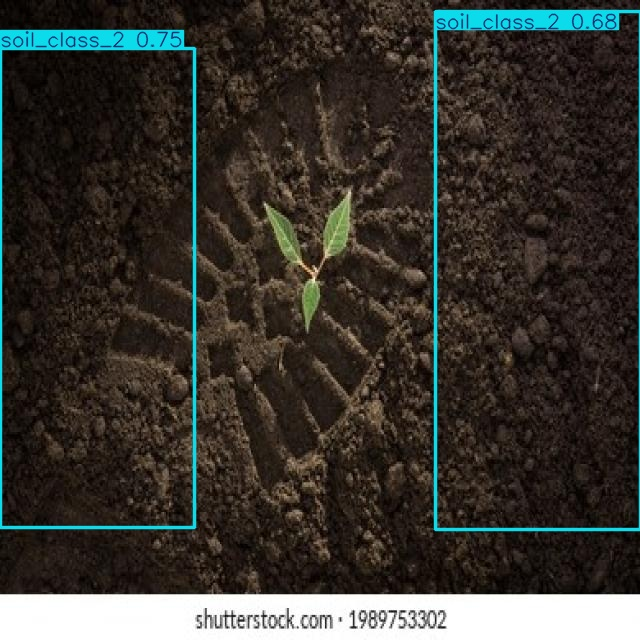

Displaying: closeup-plowed-field-fertile-black-260nw-1831062274_jpg.rf.78ff99b9a89318760278d18356165383.jpg


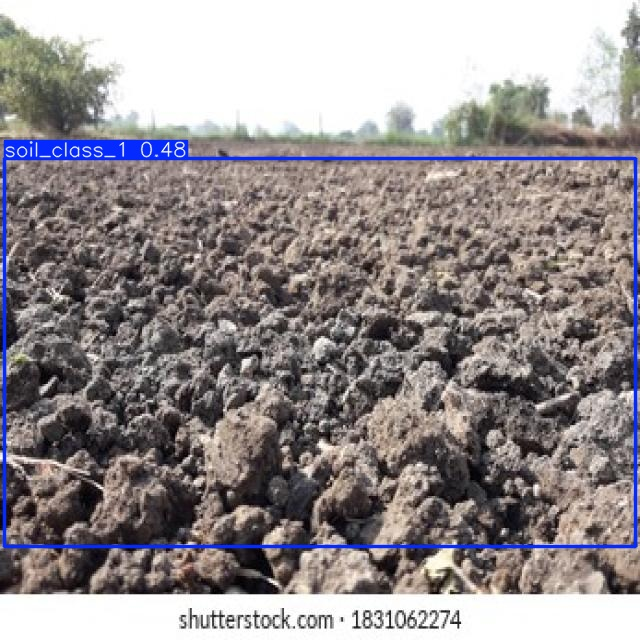

Displaying: Black_38_jpg.rf.cce2afe5e739cb1d77fbdfd7d51d5012.jpg


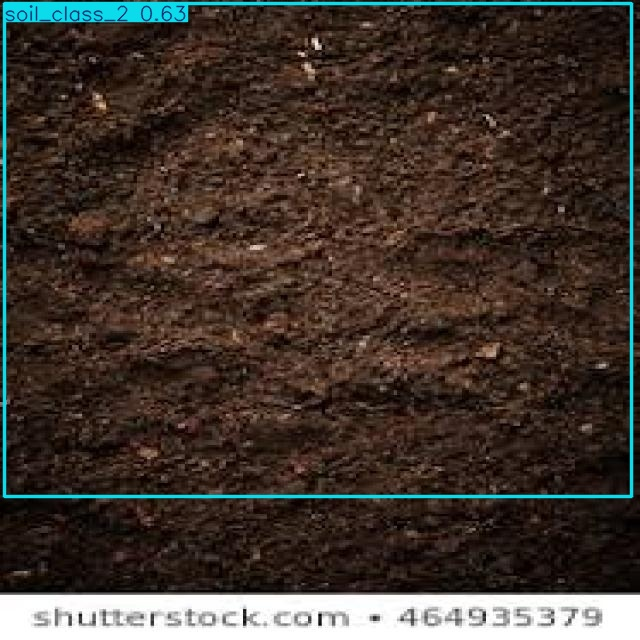

Displaying: soil-upper-layer-earth-which-600w-1857677119_jpg.rf.5f603136d0837aac5e26e4f5efd312e4.jpg


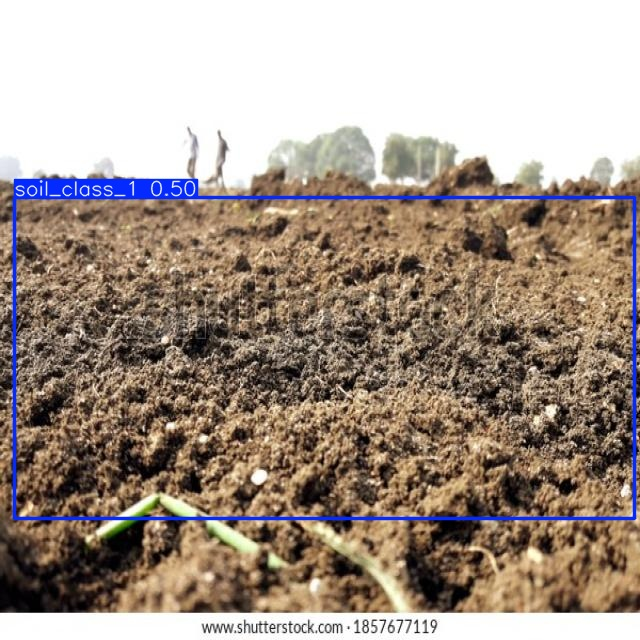

Displaying: OIP-DYv2HhVuCZkJuo6K4NcjgwHaE6_jpg.rf.a8bb88577cd95755f1a788edae3fdcaf.jpg


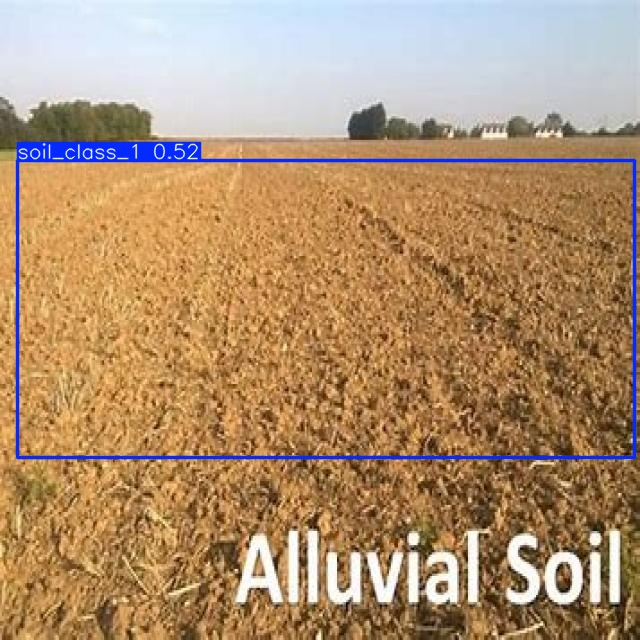

Displaying: Clay_47_jpg.rf.75ea8b632fb8f5e1a540b31945d9ff4d.jpg


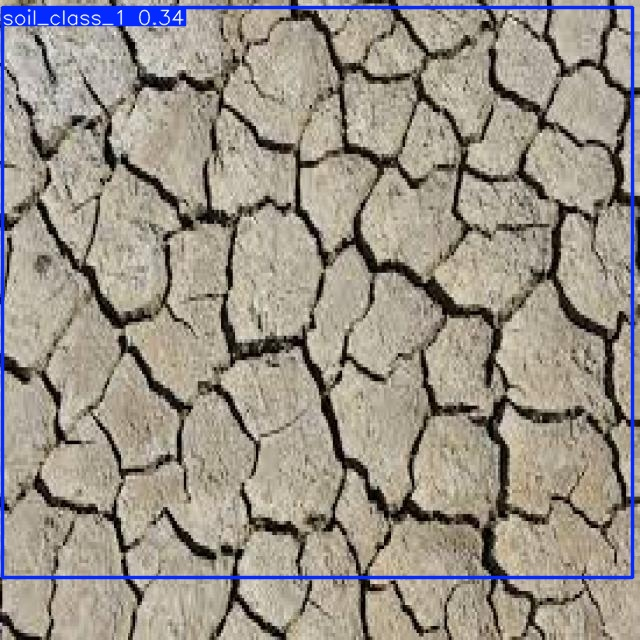

Displaying: Red_44_jpg.rf.166b249f96dfcba4e9996f754ed4ecaf.jpg


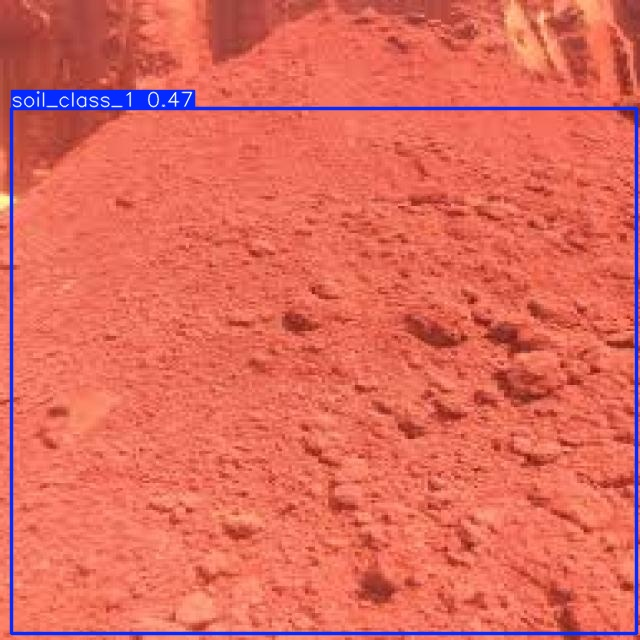

Displaying: brown-soil-texture-background-cultivated-260nw-1898667757_jpg.rf.5acd27a74577427cfe6208a238b19114.jpg


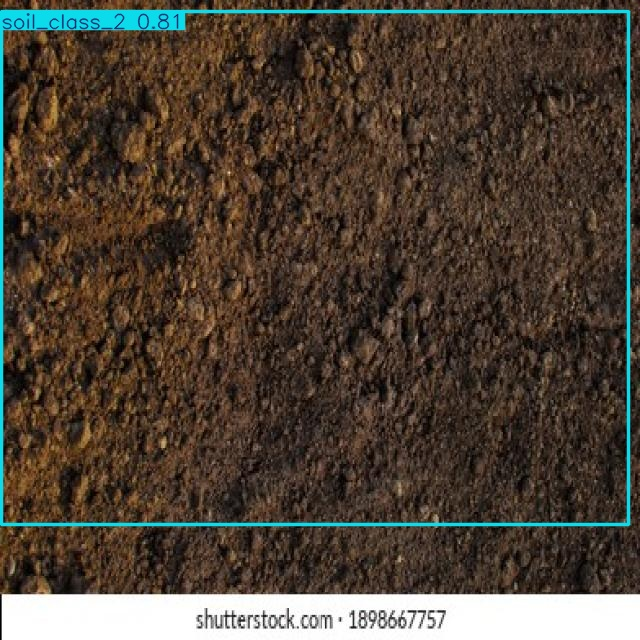

Displaying: closeup-black-color-soil-texture-260nw-570892720_jpg.rf.a63db07d023f79d6c7c0a4afac5e5c5e.jpg


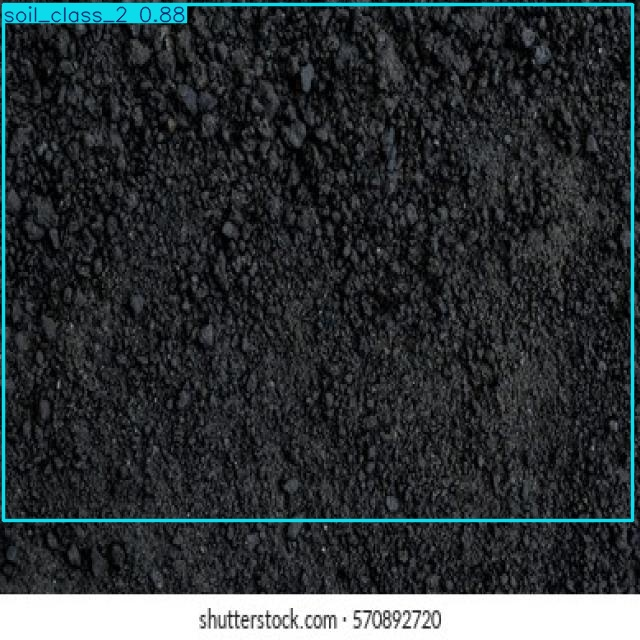

Displaying: Copy-of-image15_jpeg.rf.4dcea00f6cf966d634e331ab311cbdca.jpg


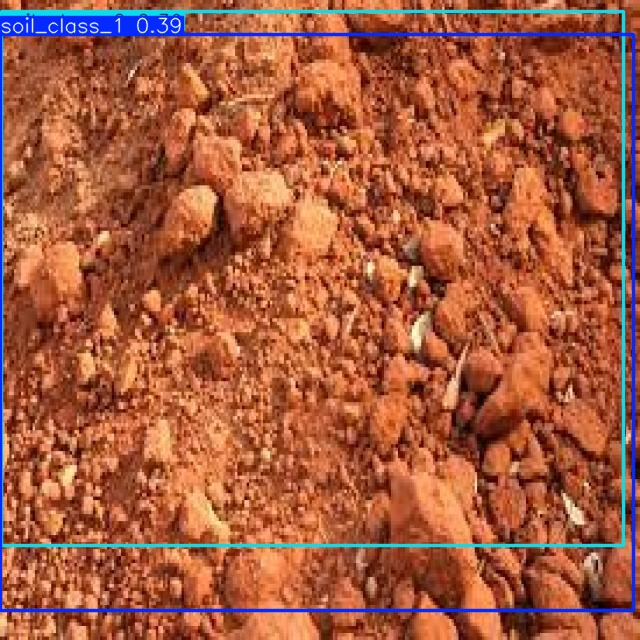

Displaying: Black_44_jpg.rf.bfb078e5b0304edb36b2cc1d57ea3cbc.jpg


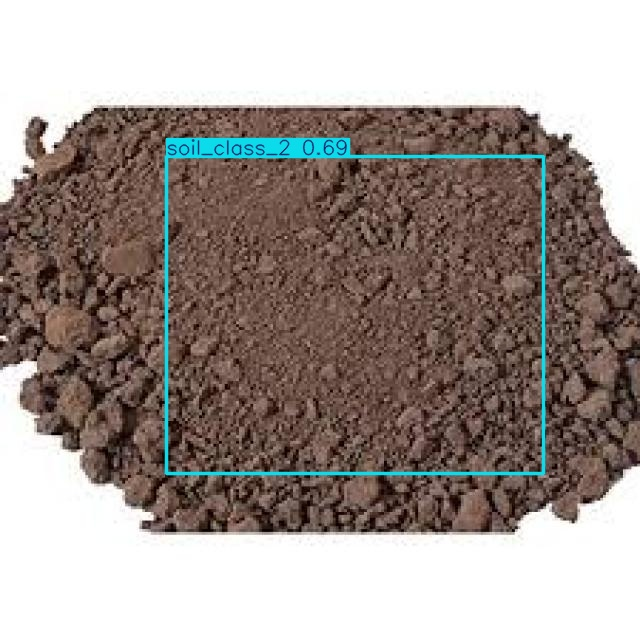

Displaying: alluvial-soil-geographical-study-reference-600w-1988780216_jpg.rf.212572abc4ca1273ec29a6529edd8e83.jpg


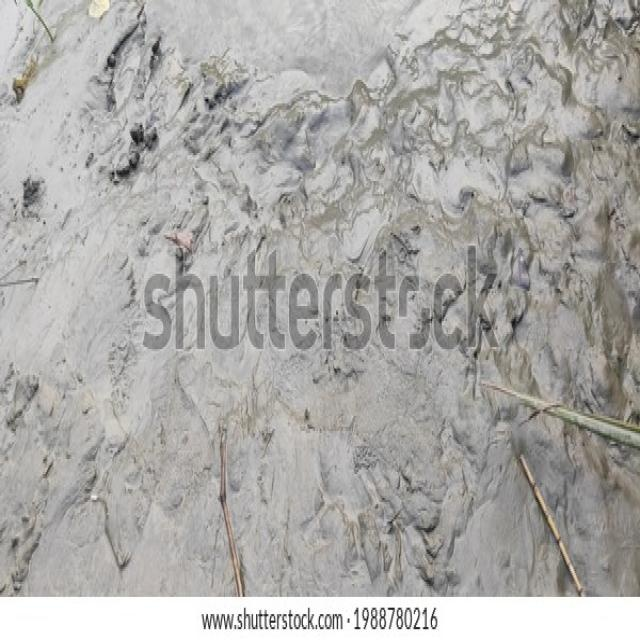

Displaying: closeup-alluvial-soil-texturebackground-260nw-524203225_jpg.rf.6ee841398ad839c9ec9dc5fdda5d4099.jpg


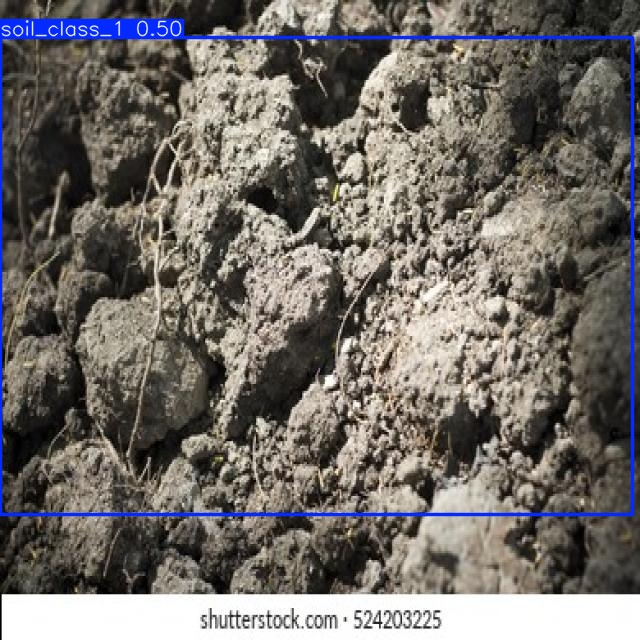

Displaying: dried-cracked-earth-soil-ground-260nw-519337915_jpg.rf.d14cad1c7ef3738d4e1a4a586f7e3e81.jpg


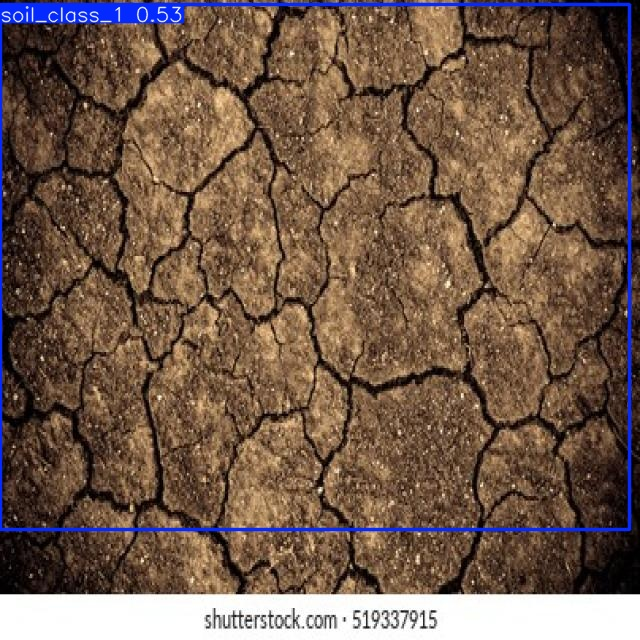

Displaying: OIP-raUzyqtNr7IxQ0aTNBpYYAHaJ4_jpg.rf.5f04ee10efec74d9f7bfc0b3b66e07e5.jpg


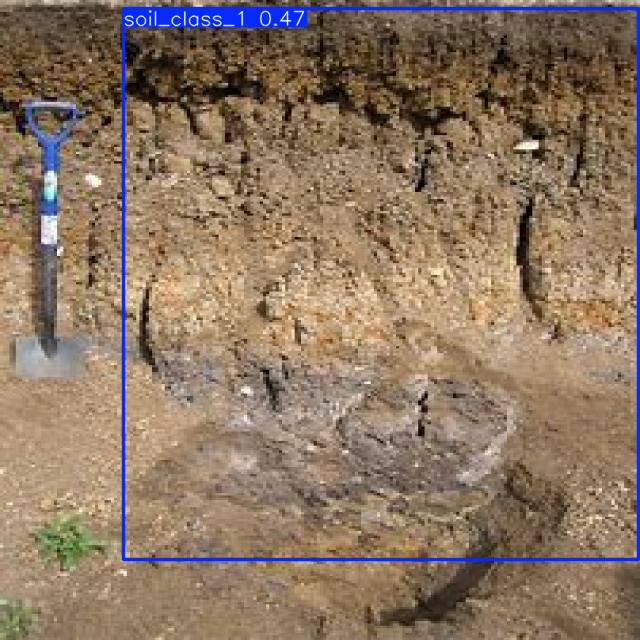

Displaying: Copy-of-images391_jpg.rf.d6806cb6a184655da8cdd3a57cfcd371.jpg


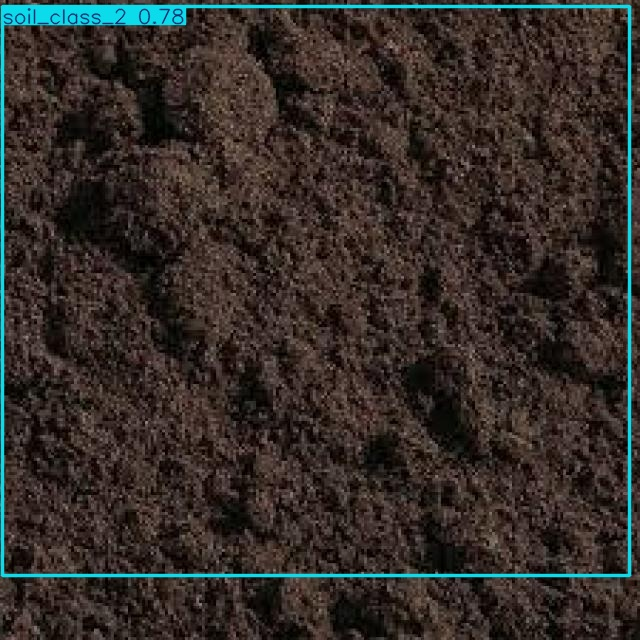

Displaying: OIP-HxR3HmFmEDtRwv49xNa6tAHaFc_jpg.rf.3e0b4def7e54f277d2085d8e99237e23.jpg


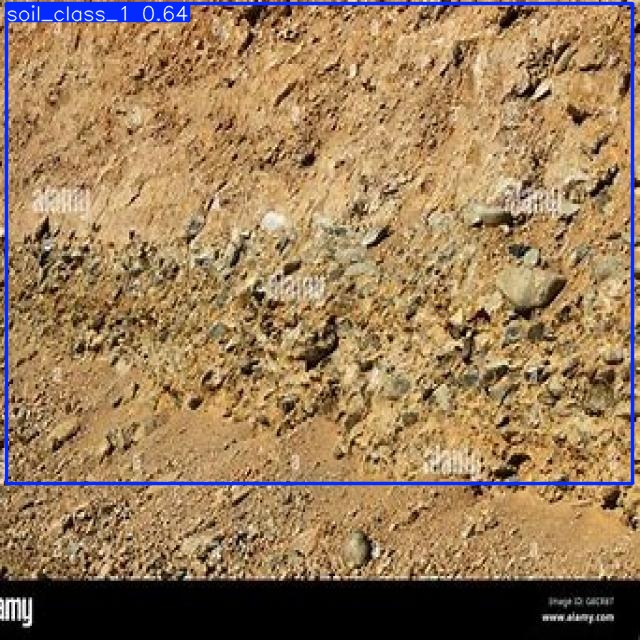

Displaying: Copy-of-clay-soil-cropped_jpg.rf.9dfcef24065c2fa79a282f89bff22b80.jpg


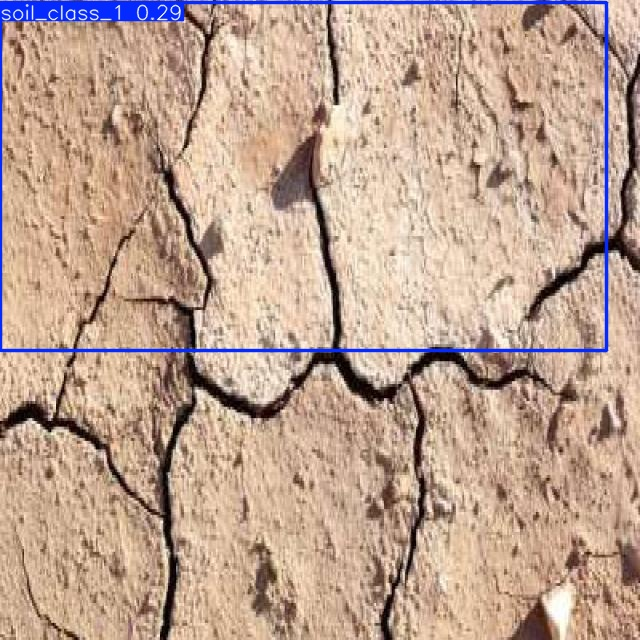

Displaying: seedbed-high-resolution-image-260nw-1268644045_jpg.rf.1b4cb73d0614d4b333ada21923d7aede.jpg


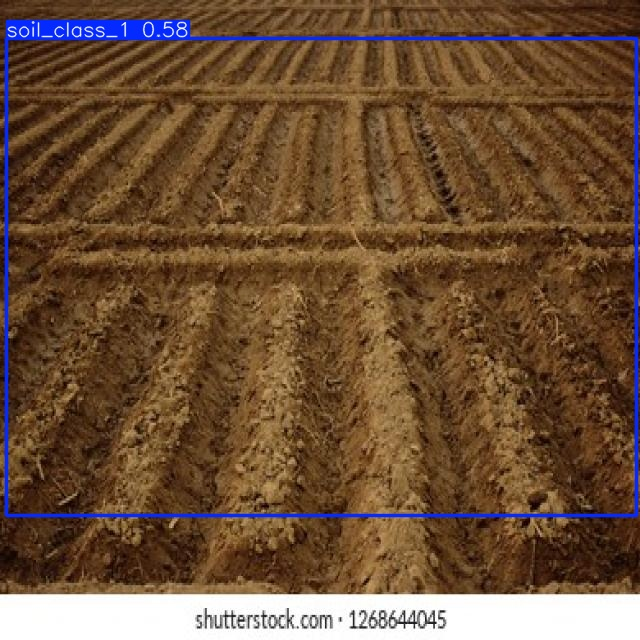

In [ ]:
import os
from IPython.display import display, Image

predict_folder = "/content/runs/detect/predict"
for img_file in os.listdir(predict_folder):
    if img_file.endswith((".jpg", ".png", ".jpeg")):
        print(f"Displaying: {img_file}")
        display(Image(filename=os.path.join(predict_folder, img_file)))

In [ ]:
from ultralytics import YOLO

# Load your trained model
model = YOLO("/content/drive/MyDrive/yolov11/results/soil_yolov11/weights/best.pt")

# Path of the input image
image_path = "/content/drive/MyDrive/yolov11/Soil detection/test/images/Black_38_jpg.rf.cce2afe5e739cb1d77fbdfd7d51d5012.jpg"

# Predict
results = model.predict(source=image_path)

# Extract detected class names
for result in results:   # results can have multiple images
    boxes = result.boxes  # detected boxes
    for box in boxes:
        cls_id = int(box.cls[0])  # class index
        cls_name = model.names[cls_id]  # class name
        conf = float(box.conf[0])  # confidence score
        print(f"Detected: {cls_name} with confidence {conf:.2f}")



image 1/1 /content/drive/MyDrive/yolov11/Soil detection/test/images/Black_38_jpg.rf.cce2afe5e739cb1d77fbdfd7d51d5012.jpg: 640x640 1 soil_class_2, 9.2ms
Speed: 1.5ms preprocess, 9.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Detected: soil_class_2 with confidence 0.63
